## Loan Default: EDA / Statistics
In the data wrangling notebook the original dataset of shape (105471,751) is reduced columnwise using filter and ensemble feature selection methods.  The selected features for each process are saved as a list and stored as values in a dictionary.  In addition, the entire feature space minus the object columns are saved in the dictionary with the key name 'all_cols.' This list of features will be used for dimension reduction.  Given the large feature space of eac feature selection method the intersection of columns resulting from the filter and ensemble are used in this analysis.  This is done to look at features that appear to be relevant in each process.

In [2]:
#Import pacakges
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [4]:
#open and load json file with feature selected columns
with open('feats_list.json', 'r') as fp:
    data = json.load(fp)

In [5]:
#Get key names
data.keys()

dict_keys(['filt_cols', 'rf_cols', 'all_cols'])

In [6]:
#create lists of columns for each filter selection method and all_cols
fm_cols = data['filt_cols']
rf_cols = data['rf_cols']
all_cols = data['all_cols']

In [7]:
#Load original data set
df = pd.read_csv('C:\\Users\\pseudo_bounce\\Desktop\\recent_dl\\loan-default-prediction\\train.csv')

C:\Users\pseudo_bounce\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3063: DtypeWarning: Columns (135,204,274,417) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [8]:
#Create binary variable from target column 'loss'
#drop loss column
df['default'] = df['loss'].apply(lambda x: 1 if x > 0 else x)
df.drop('loss',axis=1,inplace=True)

In [9]:
#create dataframes for all_cols and filter selection methods
filt_cols = df[fm_cols]
rf_cols = df[rf_cols]
all_cols = df[all_cols]

In [10]:
print(f'all_cols df shape is: {all_cols.shape}')
print(f'Filter method df shape is: {filt_cols.shape}')
print(f'Random forest method df shape is: {rf_cols.shape}')

all_cols df shape is: (105471, 751)
Filter method df shape is: (105471, 53)
Random forest method df shape is: (105471, 334)


In [11]:
filt_cols = set(filt_cols.columns)
rf_cols = set(rf_cols.columns)

In [12]:
#Look at intersection of selected column groups
intersect_cols = list(filt_cols.intersection(rf_cols))
len(intersect_cols)

30

In [13]:
cross_df = df[intersect_cols]

In [14]:
cross_df['default'].value_counts()

0    95688
1     9783
Name: default, dtype: int64

In [15]:
cross_df.head()

,f298,f14,f292,default,f279,f158,f183,f273,f677,f151,...,f640,f314,f514,f168,f26,f219,f261,f16,f471,f161
0,0.38,0.7607,0.0,0,2.36,0.36,0.38,1196.27,3.0,0.02,...,94.417,0.38,91.293,0.42,998046.0,1.00,0.16,612922,1.17,0.38
1,0.00,0.6555,0.0,0,2.12,0.17,0.12,460.66,1.0,0.01,...,86.005,0.00,83.448,0.28,754416.0,0.94,0.04,245815,1.20,0.01
2,0.07,0.7542,0.0,0,1.61,0.31,0.19,423.40,9.0,0.13,...,88.168,0.07,96.230,0.27,1037651.0,1.85,0.02,1385872,1.17,0.01
3,0.75,0.8017,0.0,0,1.89,0.21,0.29,432.44,7.0,0.25,...,87.051,0.75,96.333,0.43,1115721.0,0.93,0.06,704687,1.13,0.60
4,0.01,0.5263,0.0,0,1.65,0.26,0.12,346.10,3.0,0.01,...,72.670,0.01,75.270,0.22,536400.0,0.75,0.02,51985,1.24,0.01


In [16]:
cross_df.columns

Index(['f298', 'f14', 'f292', 'default', 'f279', 'f158', 'f183', 'f273',
       'f677', 'f151', 'f181', 'f308', 'f19', 'f344', 'f122', 'f149', 'f251',
       'f1', 'f23', 'f674', 'f640', 'f314', 'f514', 'f168', 'f26', 'f219',
       'f261', 'f16', 'f471', 'f161'],
      dtype='object')

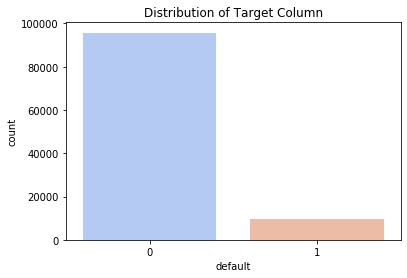

In [31]:
#Inspect distribution are target column
sns.countplot(cross_df['default'], palette='coolwarm')
plt.title('Distribution of Target Column')
plt.savefig('target.png')

The count plot shows a target distribution that is highly imbalanced.  This will result in a bias to the majority class during model fitting.  This will be addressed in the preprocessing phase with the use of synthetic minority oversampling, SMOTE.  An implementation of SMOTE is included in the python package imblearn which will be used in theis project.  This method will sample from the minority class until the two classes are balanced.

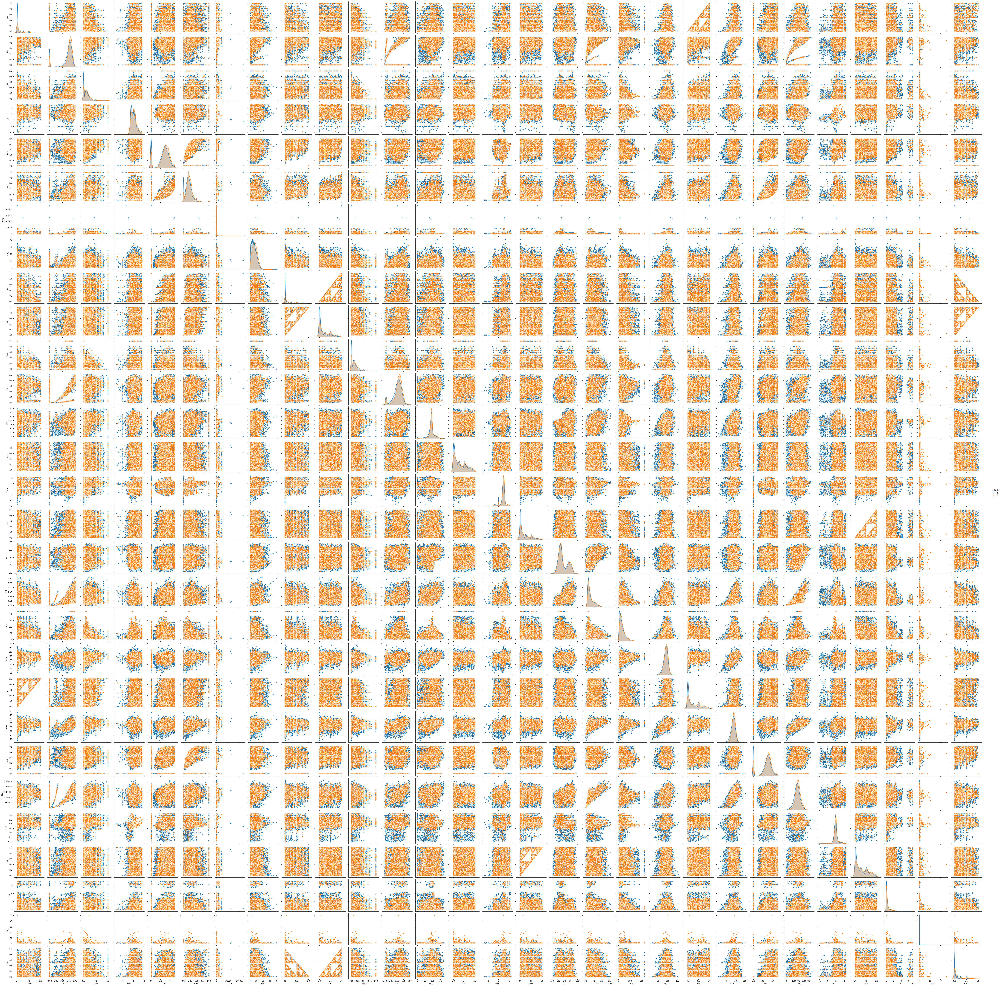

In [61]:
#create pairplot to look at feature combinations
sns.pairplot(cross_df,hue='default')

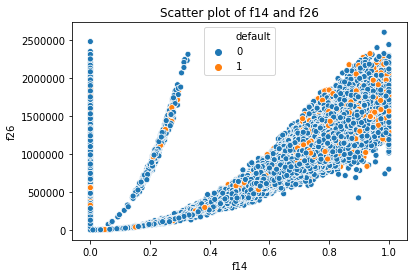

In [66]:
sns.scatterplot(data=cross_df,x = cross_df['f14'],y = cross_df['f26'],hue='default')
plt.title('Scatter plot of f14 and f26')
plt.legend(loc=0)
plt.savefig('1426.png')

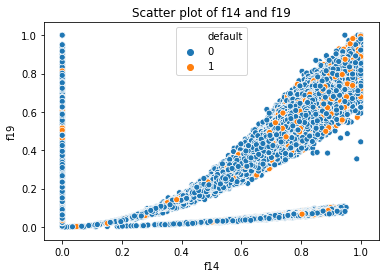

In [80]:
sns.scatterplot(data=cross_df,x=cross_df['f14'],y=cross_df['f19'],hue='default')
plt.title('Scatter plot of f14 and f19')
plt.savefig('1419.png')

In [70]:
cross_df.columns[1]

'f14'

In [67]:
cross_df.columns[]

'f292'

Looking at the pairplot we can see some scatterplot that exhibit an artificial shape.  We can look at these more closely however, due to the artificial nature these columns we be removed.

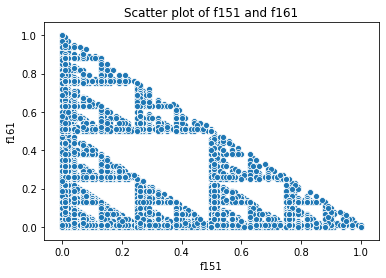

In [20]:
sns.scatterplot(cross_df['f151'],cross_df['f161'])
plt.title('Scatter plot of f151 and f161')
plt.savefig('oddscat1.png')

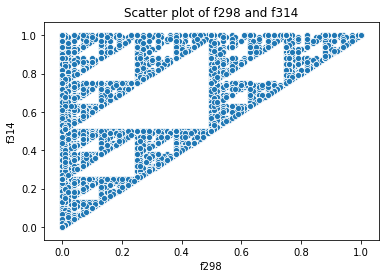

In [21]:
sns.scatterplot(cross_df['f298'],cross_df['f314'])
plt.title('Scatter plot of f298 and f314')
plt.savefig('oddscat2.png')

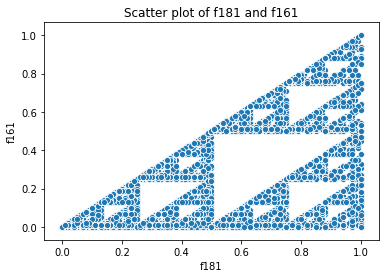

In [22]:
sns.scatterplot(cross_df['f181'],cross_df['f161'])
plt.title('Scatter plot of f181 and f161')
plt.savefig('oddscat3.png')

Text(0.5, 1.0, 'Scatter plot of f261 and f251')

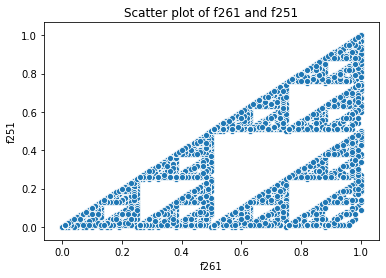

In [124]:
sns.scatterplot(cross_df['f261'],cross_df['f251'])
plt.title('Scatter plot of f261 and f251')

In [125]:
#make list of columns for future removal
cols_remove = ['f151','f161','f298','f314','f251','f261','f181']

In [179]:
#Define IQR
Q1 = cross_df.quantile(0.25)
Q3 = cross_df.quantile(0.75)
IQR = Q3 - Q1

In [178]:
#filter cross_df df with conditional statement
cross_df_or = cross_df[~((cross_df < (Q1 - 1.5 * IQR)) |(cross_df > (Q3 + 1.5 * IQR))).any(axis=1)]

In [143]:
cross_df.shape

(105471, 30)

In [144]:
cross_df_or.shape

(23943, 30)

In [158]:
f'Removing outliers based on on the IQR method reduces the sample size by {round(100 - ((cross_df_or.shape[0] / cross_df.shape[0])*100),2)}%'

'Removing outliers based on on the IQR method reduces the sample size by 77.3%'

Given that the majority of the samples contain outliers, it is better to not remove them via the IQR method as they are in some way part of the structure of the data.  In addition few of the features are normally distributed

### Compare Distributions On Target
In order to conduct some inferential statistics we need to look at two populations.  In this case we can look at the default/non-default classes.  It is already known that the distribtuion of the default feature is highly imblanced towards the non-default class.  As such we will have two samples with unequal sample sizes.  This is important to know when performing t-tests.  In performing inferential statistics on the two classes we are looking for separation between the two classes. We can do this by conducting t-tests to check for significance.

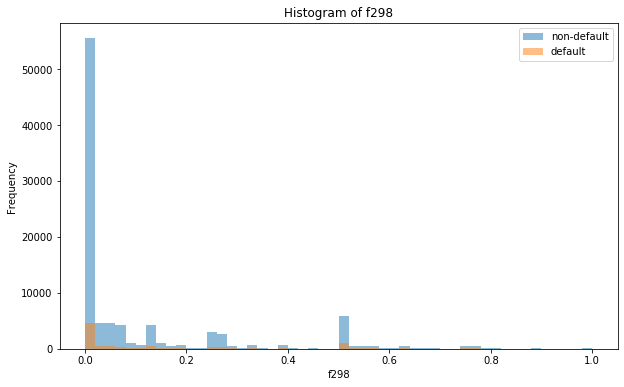

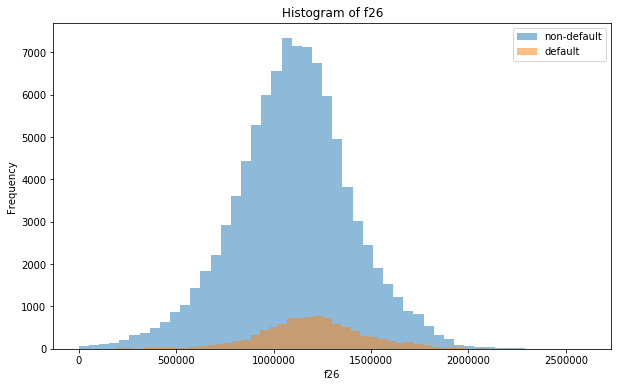

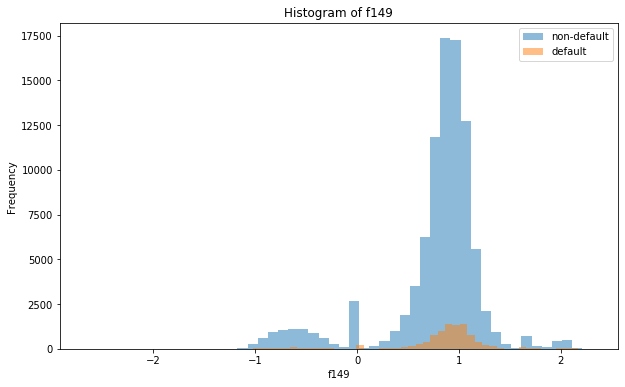

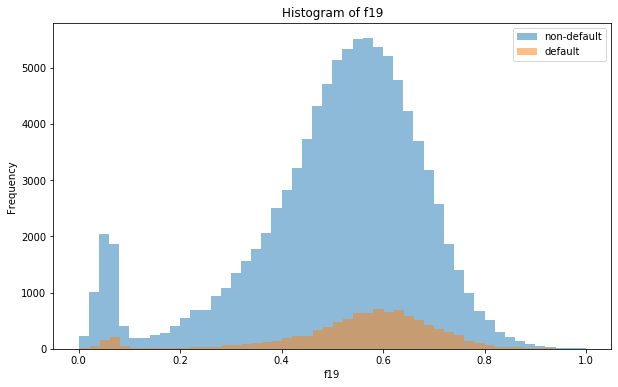

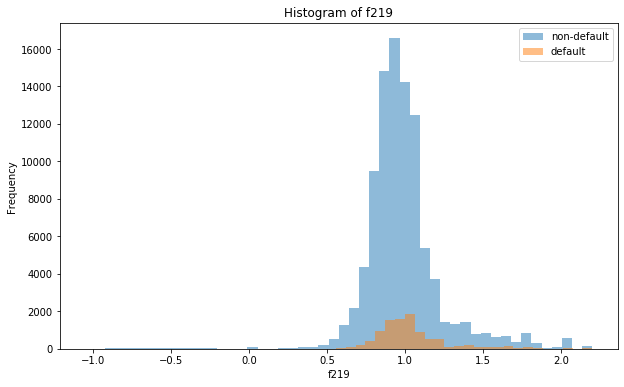

...

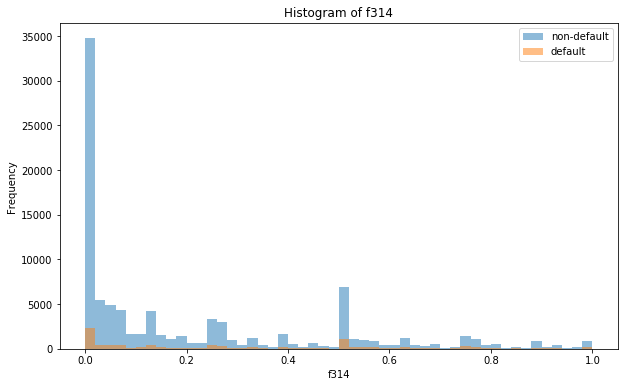

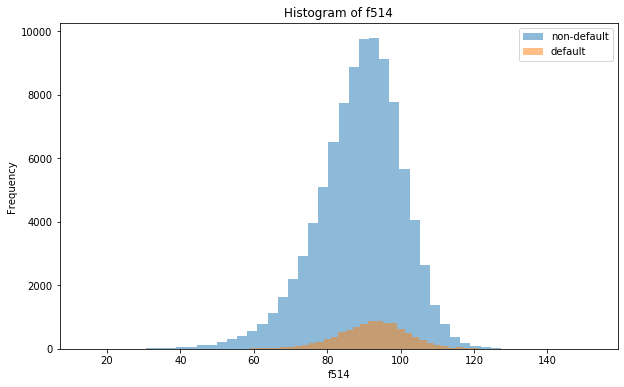

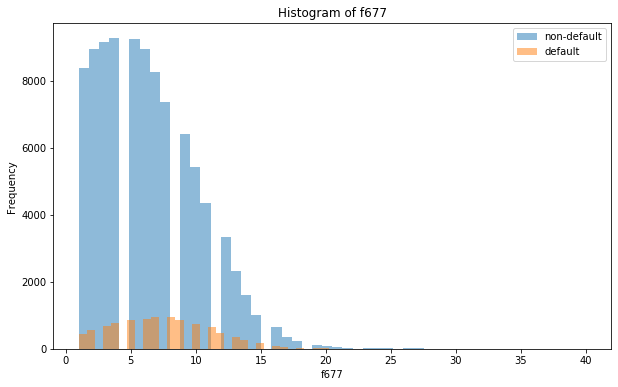

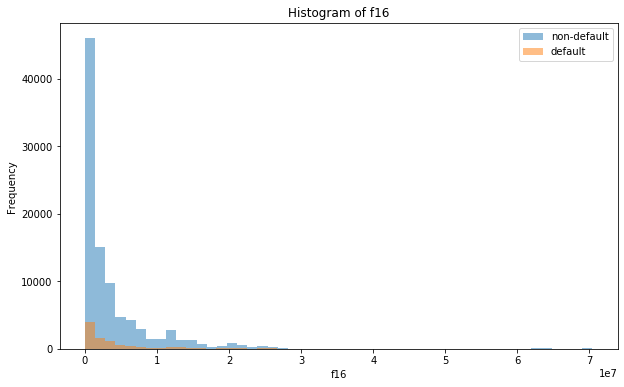

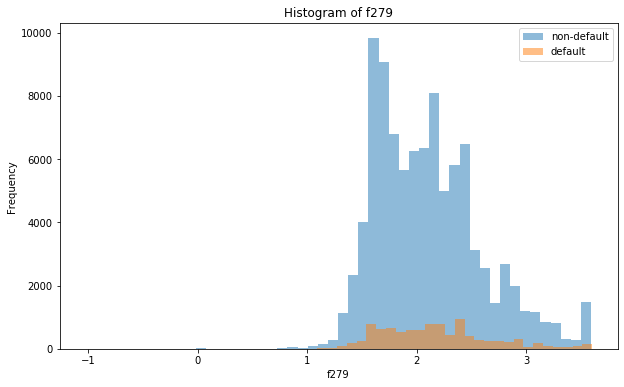

In [161]:
col = list(cross_df.columns)
for col in col:
    plt.figure(figsize=(10,6))
    plt.hist(cross_df[cross_df['default']==0][col], bins=50, alpha=0.5,label='non-default')
    plt.hist(cross_df[cross_df['default']==1][col], bins=50, alpha=0.5,label='default')
    plt.legend(loc='upper right')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.title('Histogram of {}'.format(col))
    plt.show()

### Make QQ plots for variables that appear normally distributed

In [174]:
norm_check = ['f26','f19','f219','f14','f344','f640','f514']

In [ ]:
import scipy.stats as stats

C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1912: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)


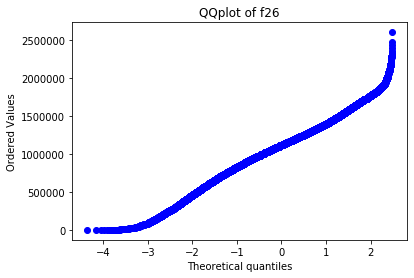

C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1912: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)


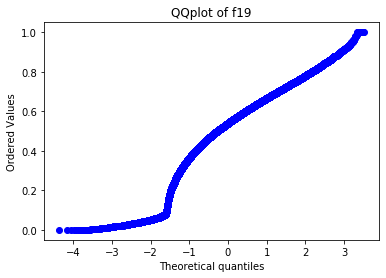

C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1912: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)


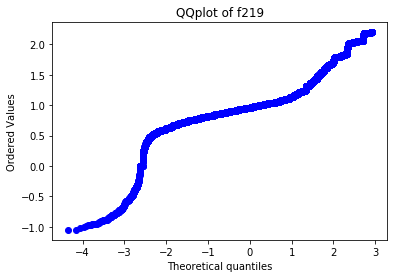

C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1912: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)


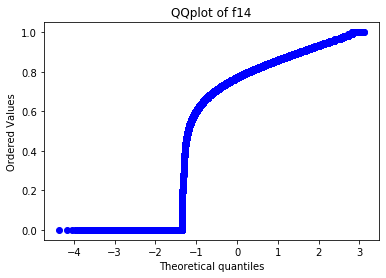

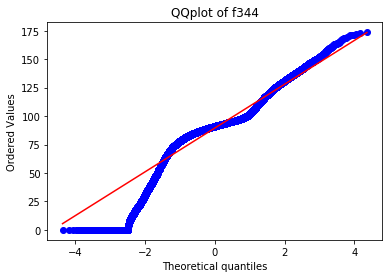

C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1912: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)


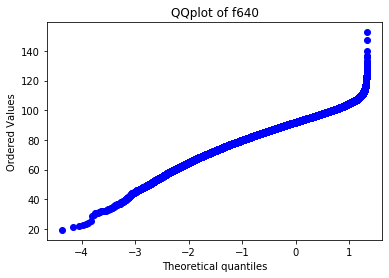

C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
C:\Users\pseudo_bounce\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1912: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)


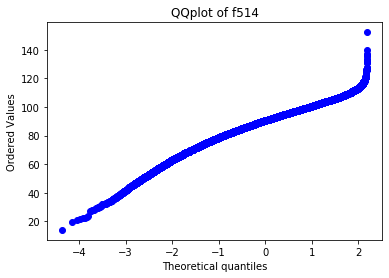

In [176]:
for col in norm_check:
    stats.probplot(cross_df[col],plot=plt)
    plt.title('QQplot of {}'.format(col))
    plt.show()
    

## T-tests for selected variables

Below are the results of t-tests for selected variables.  The null hypothesis for the t-tests are that the means for each feature per class will be the equal.  The greater the t, and p values, the greater the evidence against the null hypothesis.  In terms of model performace, we would like to reject the null hypothesis which would provide evidence the classes were drawn from different distributions

In [180]:
#drop null values from df
cross_df_drop = cross_df.dropna()

In [181]:
cross_df_drop.shape

(92533, 30)

In [189]:
#select data
non_default_f26 = cross_df_drop[cross_df_drop['default']==0]['f26']
default_f26 = cross_df_drop[cross_df_drop['default']==1]['f26']

#Look at variance for each group to determine t-test type
print(non_default_f26.var())
print(default_f26.var())

#Look a sample size of each group to determime t-test type
n1 = len(non_default_f26)
n2 = len(default_f26)

print(n1,n2)

t,p = stats.ttest_ind(non_default_f26,default_f26,equal_var=False)

df = n1-n2-2
print('t(%g) = %g, p=%g'%(df,t,p))

88202516857.77644
73637841610.401
83799 8734
t(75063) = -30.5526, p=7.18191e-197


In [190]:
#select data
non_default_f640 = cross_df_drop[cross_df_drop['default']==0]['f640']
default_f640 = cross_df_drop[cross_df_drop['default']==1]['f640']

#Look at variance for each group to determine t-test type
print(non_default_f640.var())
print(default_f640.var())

#Look a sample size of each group to determime t-test type
n1 = len(non_default_f640)
n2 = len(default_f640)

print(n1,n2)

t,p = stats.ttest_ind(non_default_f640,default_f640,equal_var=False)

df = n1-n2-2
print('t(%g) = %g, p=%g'%(df,t,p))

127.80583580992085
102.25139117171786
83799 8734
t(75063) = -18.1901, p=6.98841e-73


In [192]:
#select data
non_default_f514 = cross_df_drop[cross_df_drop['default']==0]['f514']
default_f514 = cross_df_drop[cross_df_drop['default']==1]['f514']

#Look at variance for each group to determine t-test type
print(non_default_f514.var())
print(default_f514.var())

#Look a sample size of each group to determime t-test type
n1 = len(non_default_f514)
n2 = len(default_f514)

print(n1,n2)

t,p = stats.ttest_ind(non_default_f514,default_f514,equal_var=False)

df = n1-n2-2
print('t(%g) = %g, p=%g'%(df,t,p))

124.07774036291994
90.45488083881156
83799 8734
t(75063) = -28.6957, p=6.62414e-175


The results from t-test for variables: f26, f640, f514 all show extremely low t and p values which leads to the rejection of the null hypothesis that the data are drawn from the same distribution.

## Dimension Reduction: PCA
To perform the principal component analysis we will use the dataframe that has all the columns from the original dataframe minus the object and mixed type data columns.  The shape will be examined to verify we have al the columns needed, and the null values in the dataset will be dropped in order to run the PCA.  Feature scaling will also be performed to reduce PCA's sensitivity to Euclidean distance.

In [226]:
all_cols.shape

(105471, 751)

In [23]:
#import packages
from sklearn.decomposition import PCA
import matplotlib.patches as mpatches
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [24]:
all_cols.dropna(inplace=True)

C:\Users\pseudo_bounce\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [25]:
all_cols.shape

(51940, 751)

In [26]:
y = all_cols['default']
X = all_cols.loc[:, all_cols.columns != 'default']

In [27]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [28]:
X_reduced_pca = PCA(n_components=2, random_state=42).fit_transform(X_scaled)

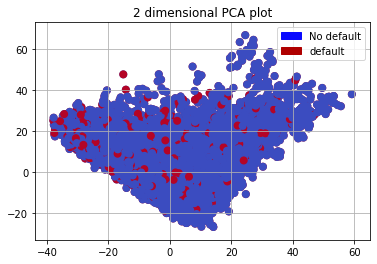

In [29]:
blue_patch = mpatches.Patch(color='#0A0AFF', label='No default')
red_patch = mpatches.Patch(color='#AF0000', label='default')

# PCA scatter plot
plt.scatter(X_reduced_pca[:,0], X_reduced_pca[:,1], c=(y == 0), cmap='coolwarm', label='No default', linewidths=2)
plt.scatter(X_reduced_pca[:,0], X_reduced_pca[:,1], c=(y == 1), cmap='coolwarm', label='Default', linewidths=2)
plt.title('2 dimensional PCA plot')


plt.grid(True)

plt.legend(handles=[blue_patch, red_patch])
plt.savefig('pca.png')

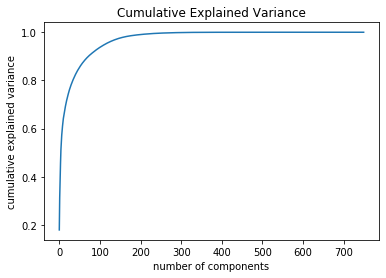

In [30]:
#PCA explained variance
pca = PCA().fit(X_scaled)
plt.figure(figsize=(6,4))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.title('Cumulative Explained Variance')
plt.savefig('cev.png')

Plotting the cumulative explained variance can help to select the number of components to keep in the modeling phase.  It looks as though 90 percent of the variance in the dataset is captured within the first 100 components.  A good number of components to keep for the model would be between 100-200, a value that would capture 90 to 99 percent of the explainced variance. By performing PCA and retaining the first 200 components, we can keep 99 percent of the variance in the data while reducing the features space from over 750 to 200.